### APC and SNIP analysis
1. APC from doaj https://doaj.org/docs/public-data-dump/ 
2. SNIP from cwts https://www.journalindicators.com/downloads

In [1]:
import pandas as pd

df_doaj = pd.read_csv('journalcsv__doaj_20220907_0635_utf8.csv')
df_cwts = pd.read_excel('CWTS Journal Indicators April 2022.xlsx')

df_doaj.rename(columns={'Journal ISSN (print version)':'Print ISSN',
                'Journal EISSN (online version)':'Electronic ISSN'}, inplace=True)


In [2]:
df_cwts.head()

,Source title,Source type,Print ISSN,Electronic ISSN,ASJC field IDs,Year,Citing source,P,IPP,IPP (lower bound),IPP (upper bound),SNIP,SNIP (lower bound),SNIP (upper bound),% self cit
0,2000 IEEE Wireless Communications and Networki...,Conference Proceeding,-,-,2200,2001,0,208,0.302885,0.201923,0.413462,0.640274,0.397300,0.919184,0.0
1,2000 IEEE Wireless Communications and Networki...,Conference Proceeding,-,-,2200,2002,0,208,0.730769,0.514423,0.985577,1.275857,0.880879,1.721015,0.0
2,2000 IEEE Wireless Communications and Networki...,Conference Proceeding,-,-,2200,2003,0,292,0.664384,0.462329,0.907534,1.263358,0.882078,1.684628,0.0
3,2000 IEEE Wireless Communications and Networki...,Conference Proceeding,-,-,2200,2004,0,84,0.440476,0.250000,0.666667,0.897186,0.472421,1.456327,0.0
4,2000 IEEE Wireless Communications and Networki...,Conference Proceeding,-,-,2200,2005,0,84,0.333333,0.166667,0.523810,0.635277,0.275482,1.086835,0.0


In [3]:
df_doaj[['APC', 'APC amount']].head()

,APC,APC amount
0,No,NaN
1,No,NaN
2,Yes,8000 PLN; 2400 EUR
3,Yes,1600 EUR
4,No,NaN


### 處理DOAJ APC
1. 以`APC amount`欄位的`USD`、`EUR`、`GBP`三種主要貨幣，統一轉換以美金計價。
2. 匯率為`USD`:1，`EUR`:0.98，`GBP`:0.86
3. 貨幣排序為`USD`、`EUR`、`GBP`
4. 轉換後儲存於`APC_USD_denominated`欄位
   

In [4]:
import re

def conv_currency(string):
    exchangeRate = [{'curr':'USD', 'rate':1}, 
                    {'curr':'EUR', 'rate':0.98},
                    {'curr':'GBP', 'rate':0.86}]
    for i in exchangeRate:
        regex = "(\d+) (" + i['curr'] + ")"

        try:
            if re.findall(regex, string):
                price, curr = re.findall(regex, string)[0]
                converted_price = int(price) * i['rate']
                break
            else:
                converted_price = ''
        except:
            converted_price = ''

    return converted_price


df_doaj['APC_USD_denominated'] = df_doaj['APC amount'].map(conv_currency)


### CWTS 期刊增加 doaj 的 ACP
1. 以`Print ISSN`與`Electronic ISSN`，將`df_cwts`、`df_doaj`關聯
2. 會有`APC_USD_denominated_x`(Print ISSN)、`APC_USD_denominated_y`(Electronic ISSN)兩個欄位
3. 將2個`APC_USD_denominated`欄位合併，以有數字的欄位為主。

In [5]:
df_cwts = pd.merge(df_cwts, df_doaj[['Print ISSN','APC_USD_denominated']], how='left', on='Print ISSN')
df_cwts = pd.merge(df_cwts, df_doaj[['Electronic ISSN','APC_USD_denominated']], how='left', on='Electronic ISSN')

df_cwts.head()

,Source title,Source type,Print ISSN,Electronic ISSN,ASJC field IDs,Year,Citing source,P,IPP,IPP (lower bound),IPP (upper bound),SNIP,SNIP (lower bound),SNIP (upper bound),% self cit,APC_USD_denominated_x,APC_USD_denominated_y
0,2000 IEEE Wireless Communications and Networki...,Conference Proceeding,-,-,2200,2001,0,208,0.302885,0.201923,0.413462,0.640274,0.397300,0.919184,0.0,NaN,NaN
1,2000 IEEE Wireless Communications and Networki...,Conference Proceeding,-,-,2200,2002,0,208,0.730769,0.514423,0.985577,1.275857,0.880879,1.721015,0.0,NaN,NaN
2,2000 IEEE Wireless Communications and Networki...,Conference Proceeding,-,-,2200,2003,0,292,0.664384,0.462329,0.907534,1.263358,0.882078,1.684628,0.0,NaN,NaN
3,2000 IEEE Wireless Communications and Networki...,Conference Proceeding,-,-,2200,2004,0,84,0.440476,0.250000,0.666667,0.897186,0.472421,1.456327,0.0,NaN,NaN
4,2000 IEEE Wireless Communications and Networki...,Conference Proceeding,-,-,2200,2005,0,84,0.333333,0.166667,0.523810,0.635277,0.275482,1.086835,0.0,NaN,NaN


In [6]:
import numpy as np

def merged(series):
    x = series['APC_USD_denominated_x']
    y = series['APC_USD_denominated_y']
    
    if x == '':
        x = np.nan
    if y == '':
        y = np.nan
    
    return x if not np.isnan(x) else y

df_cwts['APC_USD_denominated'] = df_cwts.apply(merged, axis=1)

### 繪圖

In [9]:
import plotly.express as px
fig = px.scatter(df_cwts, x='APC_USD_denominated', y="SNIP")
fig.update_layout(xaxis_range=[0,6500], yaxis_range=[0, 20])
fig.show()

In [10]:
# df_cwts.to_excel('df_cwts.xlsx')
df_cwts.to_csv('df_cwts.csv')

In [13]:
import plotly.express as px
fig = px.scatter(df, x='APC_USD_denominated', y="SNIP", hover_name='Source title')
fig.update_layout(xaxis_range=[0,6500], yaxis_range=[0, 20])
fig.show()

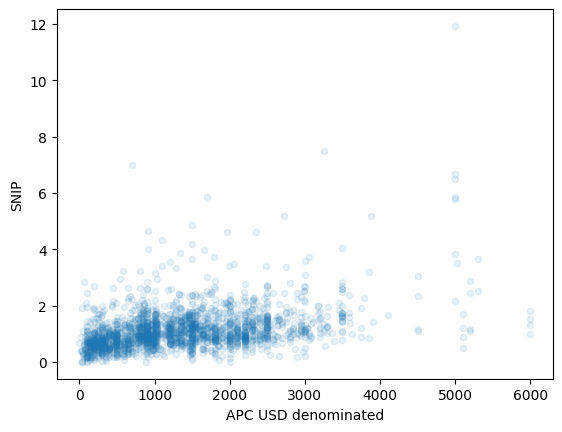

In [30]:
import pandas as pd
import matplotlib.pyplot as plt


df = pd.read_csv('df_cwts.csv')
df = df[df.Year == 2021]

fig, ax = plt.subplots()
plt.scatter(df['APC_USD_denominated'], df['SNIP'], alpha=0.1, s=20)
ax.set_xlabel('APC USD denominated')
ax.set_ylabel('SNIP')
plt.show()